## 1. Imports und Konfiguration

In [1]:
import polars as pl
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from scipy.stats import kruskal
from difflib import get_close_matches
from shapely.ops import transform
from branca.colormap import StepColormap
import numpy as np

## 2. Daten laden

In [2]:
# Verspätungsdaten laden
df = pl.scan_parquet("../data/processed/istdata_clean.parquet").with_columns(
    pl.col("BPUIC").cast(pl.Utf8).str.strip_chars()
)

In [3]:
# Bahnhofs-Daten laden und bereinigen
dienst = pd.read_csv(
    "../data/external/dienststellen.csv",
    sep=None,
    engine="python",
    encoding="utf-8"
)

# Nur Schweizer Bahnhöfe, Gemeindename bereinigen ("Zürich (Kreis 1)" -> "Zürich")
dienst_ch = dienst[
    (dienst["isoCountryCode"] == "CH") &
    (dienst["number"].notna()) &
    (dienst["municipalityName"].notna())
].copy()

dienst_ch["municipalityName"] = dienst_ch["municipalityName"].str.replace(r"\s*\(.*\)", "", regex=True)
dienst_ch = dienst_ch[["number", "municipalityName", "cantonAbbreviation"]]

# Zu Polars konvertieren
dienst2 = pl.from_pandas(dienst_ch).with_columns(
    pl.col("number").cast(pl.Utf8).str.strip_chars().alias("station_id"),
    pl.col("municipalityName").str.strip_chars().alias("gemeinde"),
    pl.col("cantonAbbreviation").str.strip_chars().alias("kanton")
).select(["station_id", "gemeinde", "kanton"])

print(f"✓ {len(dienst2)} Bahnhöfe geladen")

✓ 30587 Bahnhöfe geladen


In [4]:
# Gemeindegrenzen laden
gde = gpd.read_file("../data/external/Boundaries_K4_GDETYP2020_20240101_de.gpkg")

gde_small = gde[["GDENAME", "GDENR", "STALAN2020"]].copy()
gde_small["gemeinde"] = gde_small["GDENAME"].str.strip()

# Urban/Rural Klassifikation (STALAN2020: 1,2 = urban, rest = rural)
gde_lookup = (
    pl.from_pandas(gde_small)
    .with_columns(pl.col("STALAN2020").cast(pl.Int64))
    .with_columns(
        pl.when(pl.col("STALAN2020").is_in([1, 2]))
          .then(pl.lit("urban"))
          .otherwise(pl.lit("rural"))
          .alias("region_type")
    )
    .select(["gemeinde", "region_type"])
)

print(f"✓ {len(gde_lookup)} Gemeinden geladen")

✓ 2131 Gemeinden geladen


## 3. Gemeinde-Mapping erstellen

Problem: Gemeindenames unterscheiden sich zwischen Bahnhofsdaten und Gemeindegrenzen  
Lösung: Fuzzy Matching mit Kanton-Information

In [5]:
# Sets für Vergleich
gemeinden_bahnhoefe = set(dienst2["gemeinde"].unique())
gemeinden_grenzen = set(gde_lookup["gemeinde"].unique())
fehlend_in_grenzen = gemeinden_bahnhoefe - gemeinden_grenzen

print(f"Bahnhof-Gemeinden: {len(gemeinden_bahnhoefe)}")
print(f"Grenzen-Gemeinden: {len(gemeinden_grenzen)}")
print(f"Nicht gemappt: {len(fehlend_in_grenzen)}")

# Mapping mit Kanton-Information erstellen
gemeinde_mapping = {}

for bahnhof_gemeinde in fehlend_in_grenzen:
    # Kanton dieser Bahnhof-Gemeinde holen
    kanton_row = dienst2.filter(pl.col("gemeinde") == bahnhof_gemeinde).select("kanton").head(1)
    if len(kanton_row) == 0:
        continue
    kanton = kanton_row[0, 0]
    
    # Variante 1: Exakte Ergänzung mit Kanton: "Gossau" -> "Gossau (SG)"
    kandidat = f"{bahnhof_gemeinde} ({kanton})"
    if kandidat in gemeinden_grenzen:
        gemeinde_mapping[bahnhof_gemeinde] = kandidat
        continue
    
    # Variante 2: Fuzzy Match innerhalb desselben Kantons
    gemeinden_im_kanton = [g for g in gemeinden_grenzen if f"({kanton})" in g or "(" not in g]
    if gemeinden_im_kanton:
        matches = get_close_matches(bahnhof_gemeinde, gemeinden_im_kanton, n=1, cutoff=0.85)
        if matches:
            gemeinde_mapping[bahnhof_gemeinde] = matches[0]

print(f"\n✓ {len(gemeinde_mapping)} Gemeinden gemappt")
print(f"\nBeispiele:")
for gemeinde in ['Gossau', 'Wil', 'Au', 'Buchs', 'Altdorf']:
    if gemeinde in gemeinde_mapping:
        print(f"  {gemeinde:20s} → {gemeinde_mapping[gemeinde]}")

Bahnhof-Gemeinden: 2038
Grenzen-Gemeinden: 2131
Nicht gemappt: 124

✓ 110 Gemeinden gemappt

Beispiele:
  Gossau               → Gossau (SG)
  Wil                  → Wil (SG)
  Au                   → Au (SG)
  Buchs                → Buchs (SG)
  Altdorf              → Altdorf (UR)


In [6]:
# Mapping auf dienst2 anwenden
dienst2_final = dienst2.with_columns(
    pl.col("gemeinde").replace_strict(gemeinde_mapping, default=None, return_dtype=pl.Utf8)
        .fill_null(pl.col("gemeinde"))
        .alias("gemeinde_mapped")
).select(["station_id", "gemeinde_mapped", "kanton"]).rename({"gemeinde_mapped": "gemeinde"})

print("✓ Gemeinde-Mapping angewendet")

✓ Gemeinde-Mapping angewendet


## 4. Daten joinen

In [7]:
# Join 1: Verspätungsdaten + Bahnhofsdaten
df_join1 = df.join(
    dienst2_final.lazy(),
    left_on="BPUIC",
    right_on="station_id",
    how="left"
)

# Join 2: + Gemeinde-Typ (urban/rural)
df_complete = df_join1.join(
    gde_lookup.lazy(),
    left_on="gemeinde",
    right_on="gemeinde",
    how="left"
)

print("✓ Daten gejoint")
df_complete.select(["BPUIC", "gemeinde", "kanton", "region_type"]).head(5).collect()

✓ Daten gejoint


BPUIC,gemeinde,kanton,region_type
str,str,str,str
"""8503424""","""Schaffhausen""","""SH""","""urban"""
"""8503424""","""Schaffhausen""","""SH""","""urban"""
"""8503424""","""Schaffhausen""","""SH""","""urban"""
"""8503424""","""Schaffhausen""","""SH""","""urban"""
"""8503424""","""Schaffhausen""","""SH""","""urban"""


## 5. Deskriptive Statistik: Urban vs Rural

In [8]:
# Nur Zeilen mit region_type
df_trains = df_complete.filter(
    pl.col("region_type").is_not_null()
).with_columns(
    (pl.col("delay_arrival_s") / 60).alias("delay_min"),
    (pl.col("delay_departure_s") / 60).alias("delay_dep_min")
)

# Statistik
delay_stats = df_trains.group_by("region_type").agg([
    pl.col("delay_min").mean().alias("mean_delay"),
    pl.col("delay_min").median().alias("median_delay"),
    pl.col("delay_min").quantile(0.9).alias("p90_delay"),
    pl.col("delay_min").quantile(0.99).alias("p99_delay"),
    pl.len().alias("count")
]).collect()

delay_stats

region_type,mean_delay,median_delay,p90_delay,p99_delay,count
str,f64,f64,f64,f64,u32
"""urban""",1.225006,0.916667,3.383333,10.416667,8904558
"""rural""",1.120051,0.866667,3.033333,8.666667,877769


### Boxplot

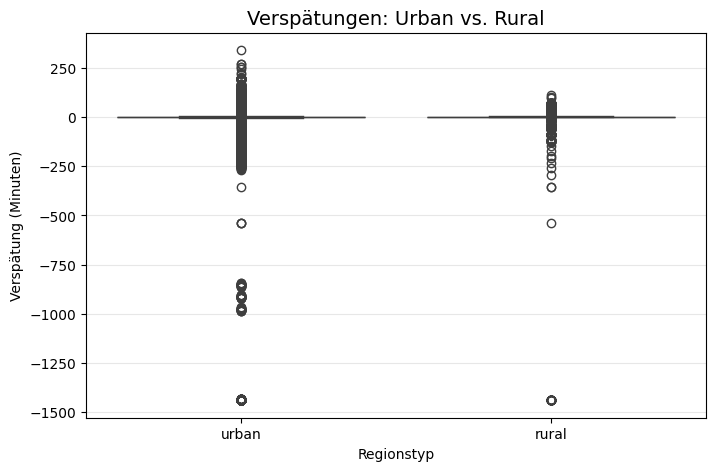

In [9]:
box_df = (
    df_trains
    .select(["region_type", "delay_min"])
    .filter(pl.col("region_type").is_not_null())
    .collect()
)

plt.figure(figsize=(8, 5))
sns.boxplot(
    data=box_df.to_pandas(),
    x="region_type",
    y="delay_min"
)
plt.title("Verspätungen: Urban vs. Rural", fontsize=14)
plt.xlabel("Regionstyp")
plt.ylabel("Verspätung (Minuten)")
plt.grid(axis='y', alpha=0.3)
plt.show()

### Statistischer Test: Kruskal-Wallis

In [ ]:
urban_vals = (
    df_trains.filter(pl.col("region_type")=="urban")
             .select("delay_min").collect()["delay_min"].to_list()
)

rural_vals = (
    df_trains.filter(pl.col("region_type")=="rural")
             .select("delay_min").collect()["delay_min"].to_list()
)

result = kruskal(urban_vals, rural_vals)
print(f"Kruskal-Wallis Test")
print(f"Statistik: {result.statistic:.2f}")
print(f"p-Wert: {result.pvalue:.4e}")
print(f"\nSignifikant unterschiedlich: {'Ja' if result.pvalue < 0.05 else 'Nein'}")

Kruskal-Wallis Test
Statistik: 34.40
p-Wert: 4.4935e-09

Signifikant unterschiedlich: Ja


: 

## 6. Geografische Analyse: Verspätungen pro Gemeinde

In [ ]:
# Gemeinde-Verspätungen berechnen (mit Ausreißer-Filter und Mindestanzahl Züge)
gemeinde_delay = (
    df_complete
    .with_columns((pl.col("delay_arrival_s") / 60).alias("delay_min"))
    .filter(
        (pl.col("delay_min") >= -60) & (pl.col("delay_min") <= 60)
    )
    .group_by("gemeinde")
    .agg([
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.col("region_type").first(),
        pl.len().alias("n_trains")
    ])
    .filter(pl.col("n_trains") >= 100)  # Mindestens 100 Züge
    .collect()
)

print(f"✓ {len(gemeinde_delay)} Gemeinden mit >= 100 Zügen")
print(f"\nVerspätungs-Statistik:")
print(f"  Min:    {gemeinde_delay['mean_delay'].min():.2f} min")
print(f"  Median: {gemeinde_delay['mean_delay'].median():.2f} min")
print(f"  Mean:   {gemeinde_delay['mean_delay'].mean():.2f} min")
print(f"  Max:    {gemeinde_delay['mean_delay'].max():.2f} min")

# Top 10 Gemeinden mit höchsten Verspätungen
print(f"\nTop 10 Gemeinden mit höchsten Verspätungen:")
gemeinde_delay.sort("mean_delay", descending=True).head(10)

### Choropleth-Karte: Verspätungen nach Gemeinde

In [ ]:
# Geodaten vorbereiten
gde_map = gde.copy()
gde_map["gemeinde"] = gde_map["GDENAME"].str.strip()

# 3D zu 2D konvertieren
def remove_z(geom):
    if geom.has_z:
        return transform(lambda x, y, z=None: (x, y), geom)
    return geom

gde_map["geometry"] = gde_map["geometry"].apply(remove_z)

# Mit Verspätungsdaten mergen
gde_with_delays = gde_map.merge(
    gemeinde_delay.to_pandas(),
    on="gemeinde",
    how="left"
)

# Zu WGS84 konvertieren
gde_with_delays = gde_with_delays.to_crs(epsg=4326)

print("✓ Geodaten vorbereitet")

✓ Geodaten vorbereitet


In [ ]:
# Karte erstellen
m = folium.Map(location=[46.8, 8.2], zoom_start=8, tiles='cartodbpositron')

# Farbskala
colormap = StepColormap(
    colors=['#006400', '#90EE90', '#FFFF00', '#FFA500', '#FF4500', '#8B0000'],
    vmin=-6,
    vmax=6,
    index=[-6, -1, 0, 1, 2, 4, 6],
    caption='Durchschnittliche Verspätung (Minuten)'
)

# Style-Funktion
def style_function(feature):
    delay = feature['properties']['mean_delay']
    if pd.isna(delay):
        return {
            'fillColor': '#CCCCCC',
            'color': 'white',
            'weight': 0.8,
            'fillOpacity': 0.6
        }
    else:
        return {
            'fillColor': colormap(delay),
            'color': 'white',
            'weight': 0.8,
            'fillOpacity': 0.85
        }

# Highlight beim Hover
def highlight_function(feature):
    return {
        'fillColor': '#000000',
        'color': '#000000',
        'fillOpacity': 0.3,
        'weight': 3
    }

# Layer hinzufügen
folium.GeoJson(
    gde_with_delays,
    style_function=style_function,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['gemeinde', 'mean_delay', 'region_type', 'n_trains'],
        aliases=['Gemeinde:', 'Verspätung (min):', 'Typ:', 'Anzahl Züge:'],
        localize=True,
        sticky=False
    )
).add_to(m)

# Legende
colormap.add_to(m)

# Titel
title_html = '''
<div style="position: fixed; 
            top: 10px; left: 50px; width: 450px; height: 65px; 
            background-color: white; border:2px solid grey; z-index:9999; 
            font-size:15px; padding: 10px">
<b>Durchschnittliche Verspätungen nach Gemeinde</b><br>
<span style="color: #006400;">■</span> Verfrüht (&lt; -1 min) | 
<span style="color: #90EE90;">■</span> Pünktlich (-1 bis 0) | 
<span style="color: #FFFF00;">■</span> Leicht verspätet (0-1) | 
<span style="color: #FFA500;">■</span> Verspätet (1-2) | 
<span style="color: #FF4500;">■</span> Stark verspätet (&gt;2)
</div>
'''
m.get_root().html.add_child(folium.Element(title_html))

m

## 7. Fazit

- **Urban vs Rural:** Statistisch signifikanter Unterschied in den Verspätungen
- **Geografische Muster:** Deutliche regionale Unterschiede sichtbar
- **Datenqualität:** 918 Gemeinden mit >= 100 Zügen analysiert

  region_type  delay_min
0       urban   1.900000
1       urban   0.700000
2       urban   0.516667
3       urban   0.300000
4       urban   1.383333


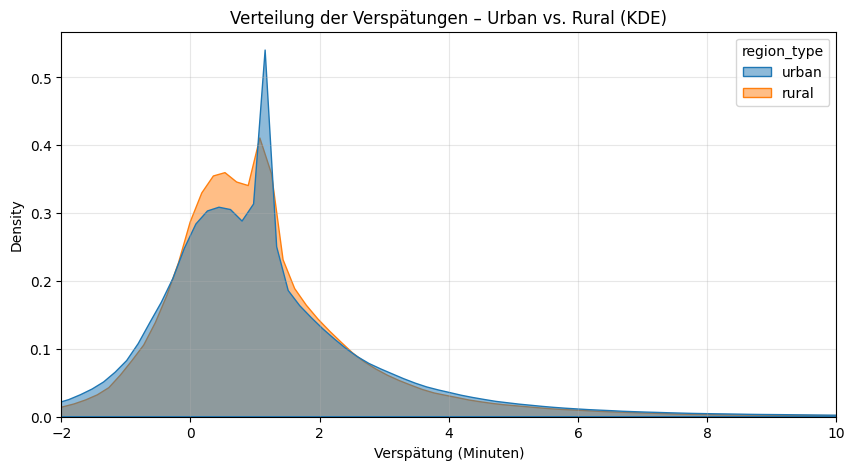

In [ ]:
# Punkt 1: KDE-Verteilung Urban vs Rural

# 1) Daten vorbereiten (Polars -> Pandas)
box_df = (
    df_trains
    .select(["region_type", "delay_min"])
    .filter(pl.col("region_type").is_not_null())
    .collect()
    .to_pandas()
)

# Optional: leichte Begrenzung extremer Ausreißer für schönere Plots
box_df = box_df[(box_df["delay_min"] >= -5) & (box_df["delay_min"] <= 30)]

print(box_df.head())

# 2) KDE-Plot
plt.figure(figsize=(10, 5))
sns.kdeplot(
    data=box_df,
    x="delay_min",
    hue="region_type",
    fill=True,
    common_norm=False,
    alpha=0.5
)
plt.xlim(-2, 10)
plt.xlabel("Verspätung (Minuten)")
plt.title("Verteilung der Verspätungen – Urban vs. Rural (KDE)")
plt.grid(alpha=0.3)
plt.show()


  region_type  hour  mean_delay
0       rural   NaN    1.150000
1       rural   0.0   -1.452727
2       rural   1.0    1.584976
3       rural   2.0   -5.653966
4       rural   3.0    1.264356


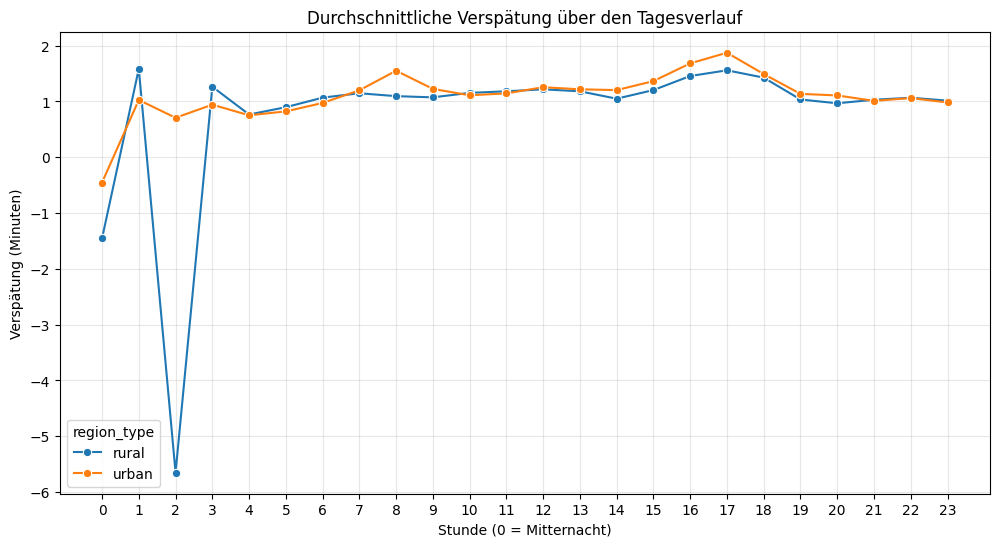

In [ ]:
# Punkt 2: Verspätungen über den Tagesverlauf (Peak Hour Analysis)

# Stunde extrahieren
df_hour = df_trains.with_columns(
    pl.col("ANKUNFTSZEIT").dt.hour().alias("hour")
)

# Aggregation
hour_stats = (
    df_hour
    .group_by(["region_type", "hour"])
    .agg(pl.col("delay_min").mean().alias("mean_delay"))
    .sort(["region_type", "hour"])
    .collect()
    .to_pandas()
)

print(hour_stats.head())

# Plot
plt.figure(figsize=(12, 6))
sns.lineplot(
    data=hour_stats,
    x="hour",
    y="mean_delay",
    hue="region_type",
    marker="o"
)

plt.title("Durchschnittliche Verspätung über den Tagesverlauf")
plt.xlabel("Stunde (0 = Mitternacht)")
plt.ylabel("Verspätung (Minuten)")
plt.grid(alpha=0.3)
plt.xticks(range(0, 24))
plt.show()


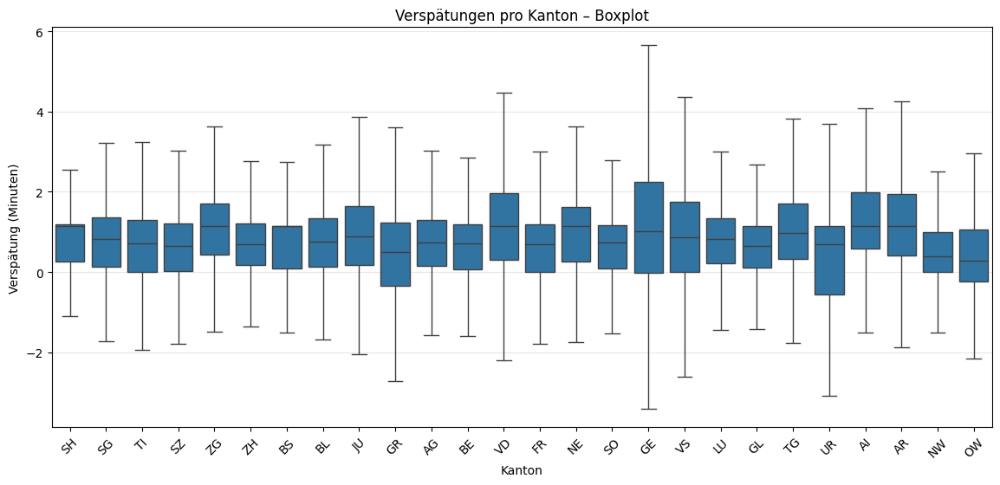

In [ ]:
# Punkt 3: Verspätungen pro Kanton visualisieren

kanton_df = (
    df_trains
    .select(["kanton", "delay_min"])
    .filter(pl.col("kanton").is_not_null())
    .collect()
    .to_pandas()
)

plt.figure(figsize=(14, 6))
sns.boxplot(
    data=kanton_df,
    x="kanton",
    y="delay_min",
    showfliers=False  # Ausreißer ausblenden für klareres Bild
)

plt.title("Verspätungen pro Kanton – Boxplot")
plt.xlabel("Kanton")
plt.ylabel("Verspätung (Minuten)")
plt.grid(axis="y", alpha=0.3)
plt.xticks(rotation=45)
plt.show()


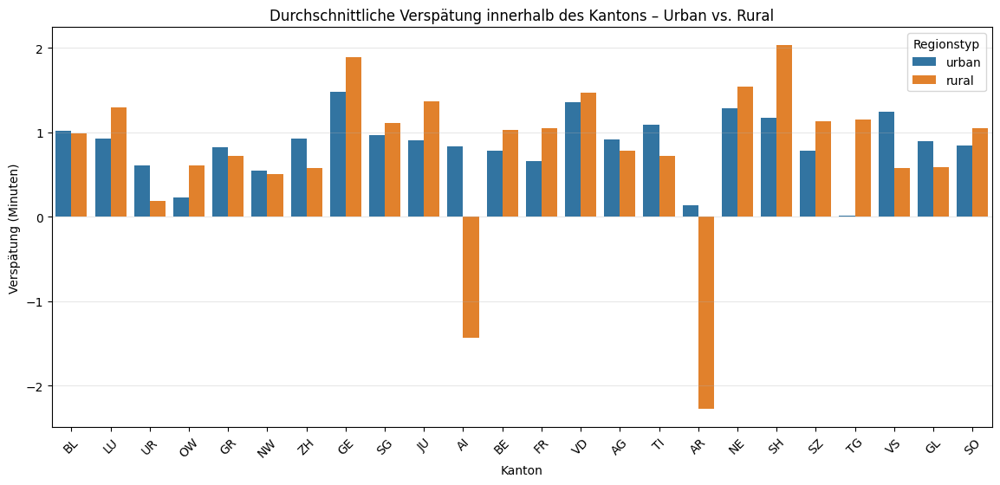

In [ ]:
# Punkt 4: Urban vs. Rural innerhalb des Kantons

kanton_region = (
    df_trains
    .select(["kanton", "region_type", "delay_min"])
    .filter(pl.col("kanton").is_not_null() & pl.col("region_type").is_not_null())
    .group_by(["kanton", "region_type"])
    .agg(pl.col("delay_min").mean().alias("mean_delay"))
    .collect()
    .to_pandas()
)

# Nur Kantone behalten, die beide Kategorien haben
valid_kantone = (
    kanton_region.groupby("kanton")["region_type"]
    .nunique()
    .reset_index()
)
valid_kantone = valid_kantone[valid_kantone["region_type"] == 2]["kanton"].tolist()

kanton_region_filtered = kanton_region[kanton_region["kanton"].isin(valid_kantone)]

# Plot
plt.figure(figsize=(14, 6))
sns.barplot(
    data=kanton_region_filtered,
    x="kanton",
    y="mean_delay",
    hue="region_type",
    palette=["#1f77b4", "#ff7f0e"]
)

plt.title("Durchschnittliche Verspätung innerhalb des Kantons – Urban vs. Rural")
plt.xlabel("Kanton")
plt.ylabel("Verspätung (Minuten)")
plt.xticks(rotation=45)
plt.grid(axis="y", alpha=0.3)
plt.legend(title="Regionstyp")
plt.show()


In [ ]:
# Tabelle: Unterschied rural - urban je Kanton

kanton_region = (
    df_trains
    .select(["kanton", "region_type", "delay_min"])
    .filter(pl.col("kanton").is_not_null() & pl.col("region_type").is_not_null())
    .group_by(["kanton", "region_type"])
    .agg(pl.col("delay_min").mean().alias("mean_delay"))
    .collect()
    .to_pandas()
)

pivot_kanton = kanton_region.pivot(
    index="kanton",
    columns="region_type",
    values="mean_delay"
).reset_index()

pivot_kanton["diff_rural_minus_urban"] = pivot_kanton["rural"] - pivot_kanton["urban"]

pivot_kanton_sorted = pivot_kanton.sort_values("diff_rural_minus_urban", ascending=False)
pivot_kanton_sorted


region_type,kanton,rural,urban,diff_rural_minus_urban
19,TG,1.153206,0.018227,1.134979
16,SH,2.029689,1.172669,0.857020
10,JU,1.365524,0.909185,0.456339
7,GE,1.886709,1.475693,0.411015
6,FR,1.046251,0.656754,0.389497
14,OW,0.609889,0.226651,0.383238
11,LU,1.298380,0.928491,0.369889
18,SZ,1.136370,0.785622,0.350748
12,NE,1.538401,1.280691,0.257710
3,BE,1.029549,0.782930,0.246619


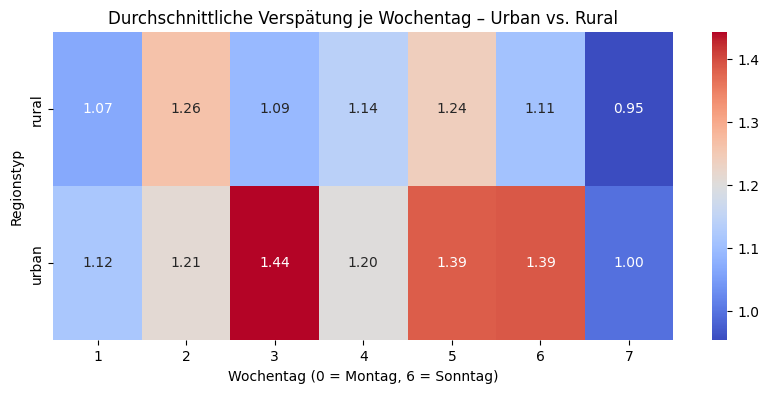

In [ ]:
# Heatmap Wochentag × Regionstyp

# Schritt 1: Wochentag extrahieren, aber nur wenn ANKUNFTSZEIT vorhanden
df_week = df_trains.with_columns(
    pl.when(pl.col("ANKUNFTSZEIT").is_not_null())
      .then(pl.col("ANKUNFTSZEIT").dt.weekday())
      .otherwise(None)
      .alias("weekday")
)

# Schritt 2: Zeilen ohne weekday entfernen
df_week = df_week.filter(pl.col("weekday").is_not_null())

# Schritt 3: aggregieren
heat_week = (
    df_week
    .group_by(["region_type", "weekday"])
    .agg(pl.col("delay_min").mean().alias("mean_delay"))
    .collect()
    .to_pandas()
)

# Schritt 4: sichere Integer-Konvertierung
heat_week["weekday"] = heat_week["weekday"].astype("Int64")  # erlaubt NaN, falls doch etwas da ist

# Schritt 5: Pivot für Heatmap
pivot = heat_week.pivot(index="region_type", columns="weekday", values="mean_delay")

plt.figure(figsize=(10, 4))
sns.heatmap(
    pivot,
    annot=True,
    cmap="coolwarm",
    fmt=".2f"
)
plt.title("Durchschnittliche Verspätung je Wochentag – Urban vs. Rural")
plt.xlabel("Wochentag (0 = Montag, 6 = Sonntag)")
plt.ylabel("Regionstyp")
plt.show()


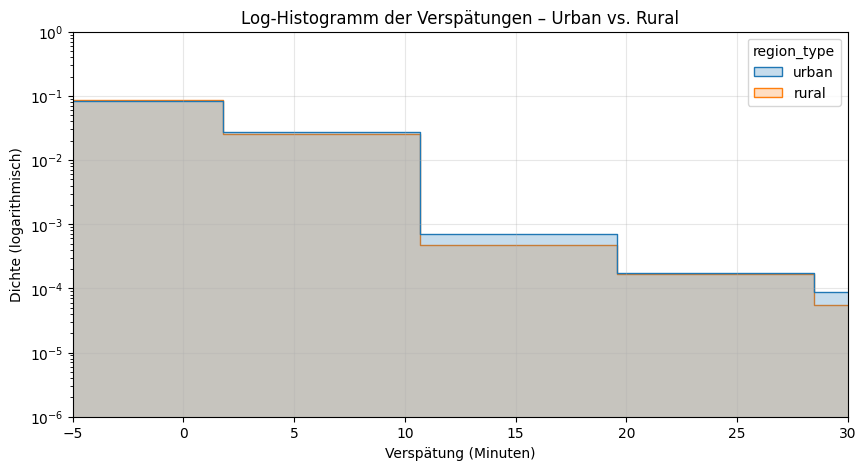

In [ ]:
# Log-Histogramm der Verspätungen (Urban vs Rural)

hist_df = df_trains.select(["region_type", "delay_min"]).collect().to_pandas()

plt.figure(figsize=(10, 5))

sns.histplot(
    data=hist_df,
    x="delay_min",
    hue="region_type",
    bins=200,
    element="step",
    stat="density",
    common_norm=False,
    log_scale=(False, True)   # y-Achse logarithmisch
)

plt.xlim(-5, 30)  # Verzögerungen über 30 min sind extrem selten, aber du kannst es anpassen
plt.ylim(1e-6, 1) # Log-Skala sorgt dafür, dass seltene Fälle sichtbar sind

plt.title("Log-Histogramm der Verspätungen – Urban vs. Rural")
plt.xlabel("Verspätung (Minuten)")
plt.ylabel("Dichte (logarithmisch)")
plt.grid(True, alpha=0.3)

plt.show()


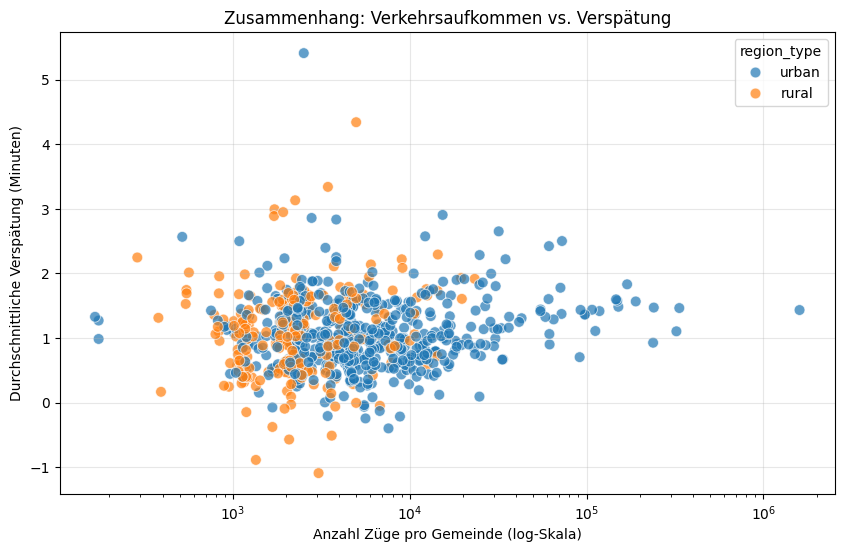

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

scatter_df = gemeinde_delay.to_pandas()

plt.figure(figsize=(10, 6))

sns.scatterplot(
    data=scatter_df,
    x="n_trains",
    y="mean_delay",
    hue="region_type",
    alpha=0.7,
    s=60
)

plt.xscale("log")  # Log, da Gemeinden stark unterschiedliche Zugzahlen haben
plt.xlabel("Anzahl Züge pro Gemeinde (log-Skala)")
plt.ylabel("Durchschnittliche Verspätung (Minuten)")
plt.title("Zusammenhang: Verkehrsaufkommen vs. Verspätung")
plt.grid(True, alpha=0.3)

plt.show()


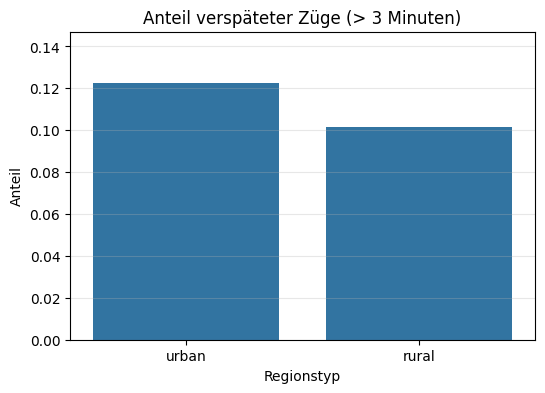

In [ ]:
# Anteil verspäteter Züge (z.B. >3 Minuten)
threshold = 3

df_flag = df_trains.with_columns(
    (pl.col("delay_min") > threshold).alias("is_delayed")
)

delay_rate = df_flag.group_by("region_type").agg(
    pl.col("is_delayed").mean().alias("delay_rate")
).collect().to_pandas()

plt.figure(figsize=(6,4))
sns.barplot(
    data=delay_rate,
    x="region_type",
    y="delay_rate"
)
plt.title(f"Anteil verspäteter Züge (> {threshold} Minuten)")
plt.ylabel("Anteil")
plt.xlabel("Regionstyp")
plt.ylim(0, delay_rate["delay_rate"].max() * 1.2)
plt.grid(axis="y", alpha=0.3)
plt.show()


/tmp/ipykernel_46965/2647631605.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


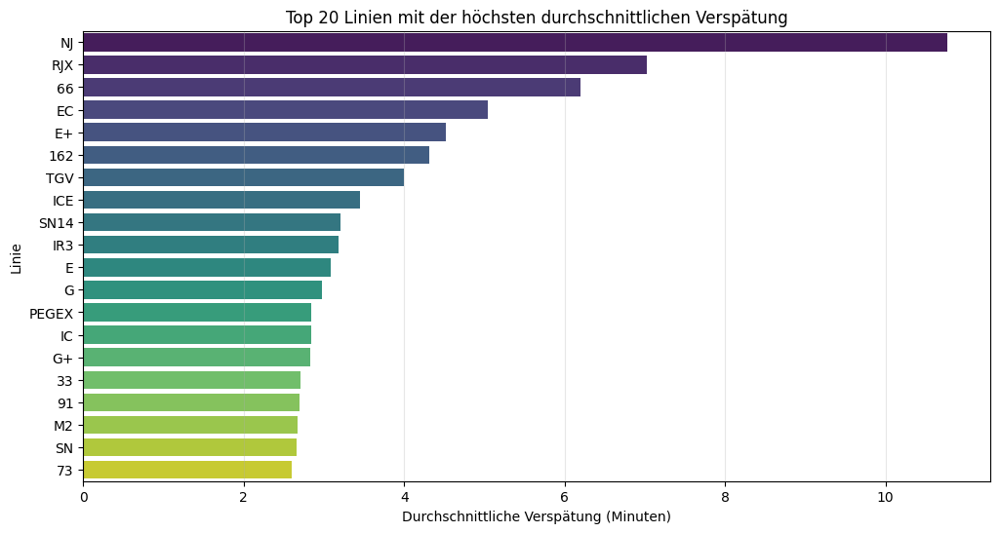

,LINIEN_TEXT,mean_delay,n_trains
0,NJ,10.771647,589
1,RJX,7.029111,1054
2,66,6.197147,10017
3,EC,5.046300,9986
4,E+,4.516513,1522
5,162,4.308893,1713
6,TGV,3.999507,1421
7,ICE,3.452712,2981
8,SN14,3.207943,384
9,IR3,3.185297,331


In [ ]:
# Linienanalyse – Durchschnittsverspätung pro LINIEN_TEXT

linien_stats = (
    df_trains.group_by("LINIEN_TEXT")
    .agg([
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.len().alias("n_trains")
    ])
    .filter(pl.col("n_trains") > 300)  # Nur Linien mit genügend Fahrten
    .sort("mean_delay", descending=True)
    .collect()
    .to_pandas()
)

plt.figure(figsize=(12, 6))
sns.barplot(
    data=linien_stats.head(20),  # Top 20 verspätete Linien
    x="mean_delay",
    y="LINIEN_TEXT",
    palette="viridis"
)
plt.title("Top 20 Linien mit der höchsten durchschnittlichen Verspätung")
plt.xlabel("Durchschnittliche Verspätung (Minuten)")
plt.ylabel("Linie")
plt.grid(axis='x', alpha=0.3)
plt.show()

linien_stats.head(20)


/tmp/ipykernel_46965/4102832956.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


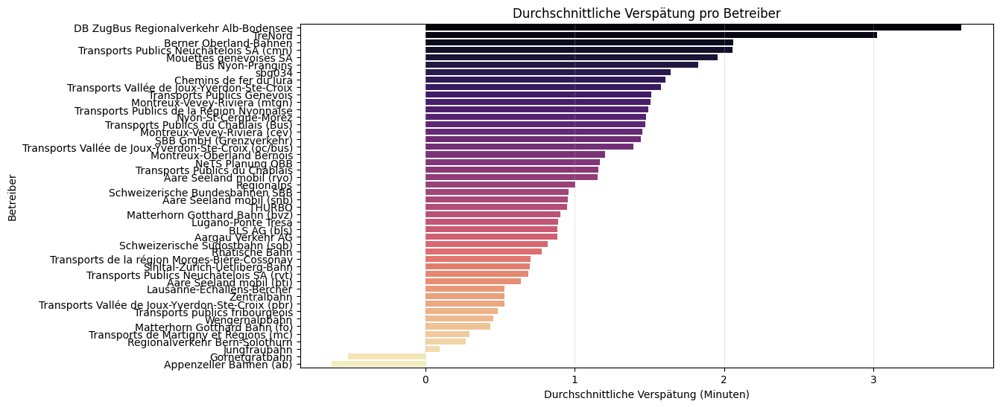

,BETREIBER_NAME,mean_delay,n_trains
0,DB ZugBus Regionalverkehr Alb-Bodensee,3.588436,1006
1,TreNord,3.023314,870
2,Berner Oberland-Bahnen,2.058793,26802
3,Transports Publics Neuchâtelois SA (cmn),2.054376,55316
4,Mouettes genevoises SA,1.956614,18190
5,Bus Nyon-Prangins,1.824683,140818
6,sbg034,1.640958,2245
7,Chemins de fer du Jura,1.605904,37537
8,Transports Vallée de Joux-Yverdon-Ste-Croix,1.575981,362665
9,Transports Publics Genevois,1.511924,4204294


: 

In [ ]:
# Betreiberanalyse – Durchschnittsverspätung pro Betreiber

betreiber_stats = (
    df_trains.group_by("BETREIBER_NAME")
    .agg([
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.len().alias("n_trains")
    ])
    .filter(pl.col("n_trains") > 500)   # Nur Betreiber mit genügend Daten
    .sort("mean_delay", descending=True)
    .collect()
    .to_pandas()
)

plt.figure(figsize=(12, 6))
sns.barplot(
    data=betreiber_stats,
    x="mean_delay",
    y="BETREIBER_NAME",
    palette="magma"
)
plt.title("Durchschnittliche Verspätung pro Betreiber")
plt.xlabel("Durchschnittliche Verspätung (Minuten)")
plt.ylabel("Betreiber")
plt.grid(axis='x', alpha=0.3)
plt.show()

betreiber_stats


In [ ]:
# Linienanalyse: Mean Delay pro LINIEN_TEXT
df_lines = (
    df_complete
    .with_columns((pl.col("delay_arrival_s") / 60).alias("delay_min"))
    .filter(pl.col("delay_min").is_not_null())
    .group_by("LINIEN_TEXT")
    .agg([
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.len().alias("n_trains")
    ])
    .filter(pl.col("n_trains") > 500)  # Filter: nur Linien mit genügend Daten
    .sort("mean_delay", descending=True)
    .collect()
)

df_lines_top20 = df_lines.head(20)

plt.figure(figsize=(10,6))
sns.barplot(
    data=df_lines_top20.to_pandas(),
    x="mean_delay",
    y="LINIEN_TEXT",
    palette="Reds_r"
)

plt.title("Top 20 verspätete Linien in der Schweiz (September 2025)")
plt.xlabel("Durchschnittliche Verspätung (Minuten)")
plt.ylabel("Linie")
plt.grid(axis='x', alpha=0.3)
plt.show()

df_lines_top20


/tmp/ipykernel_34182/1838793088.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


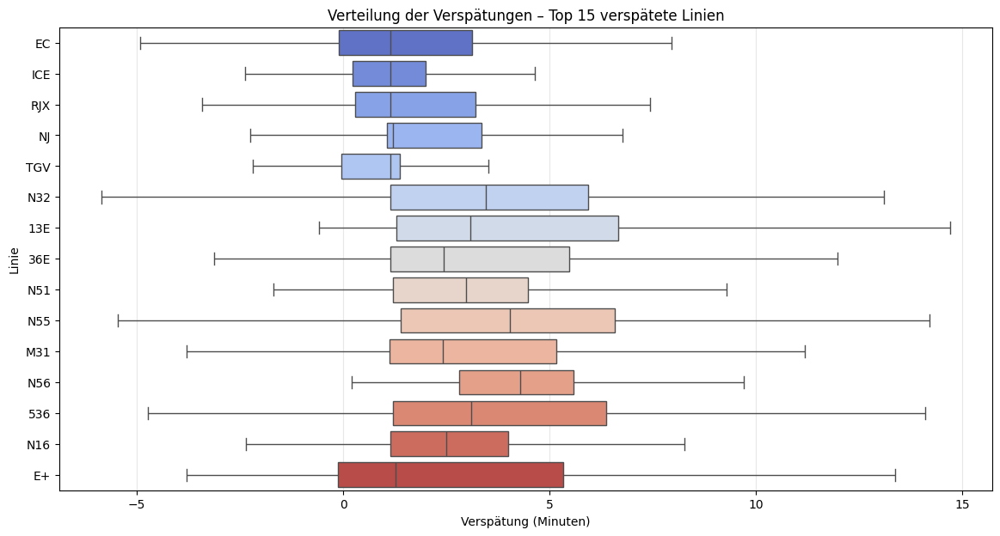

In [ ]:
# Top 15 Linien für die Boxplot-Analyse
top_lines = df_lines_top20["LINIEN_TEXT"].to_list()[:15]

# Daten für diese Linien extrahieren
df_line_delays = (
    df_complete
    .with_columns((pl.col("delay_arrival_s") / 60).alias("delay_min"))
    .filter([
        pl.col("LINIEN_TEXT").is_in(top_lines),
        pl.col("delay_min").is_not_null(),
        pl.col("delay_min") < 60,   # Ausreisser > 60 min entfernen
        pl.col("delay_min") > -10   # negative Ausreisser ebenfalls etwas beschränken
    ])
    .select(["LINIEN_TEXT", "delay_min"])
    .collect()
    .to_pandas()
)

plt.figure(figsize=(14, 7))
sns.boxplot(
    data=df_line_delays,
    x="delay_min",
    y="LINIEN_TEXT",
    palette="coolwarm",
    showfliers=False
)

plt.title("Verteilung der Verspätungen – Top 15 verspätete Linien")
plt.xlabel("Verspätung (Minuten)")
plt.ylabel("Linie")
plt.grid(axis='x', alpha=0.3)
plt.show()

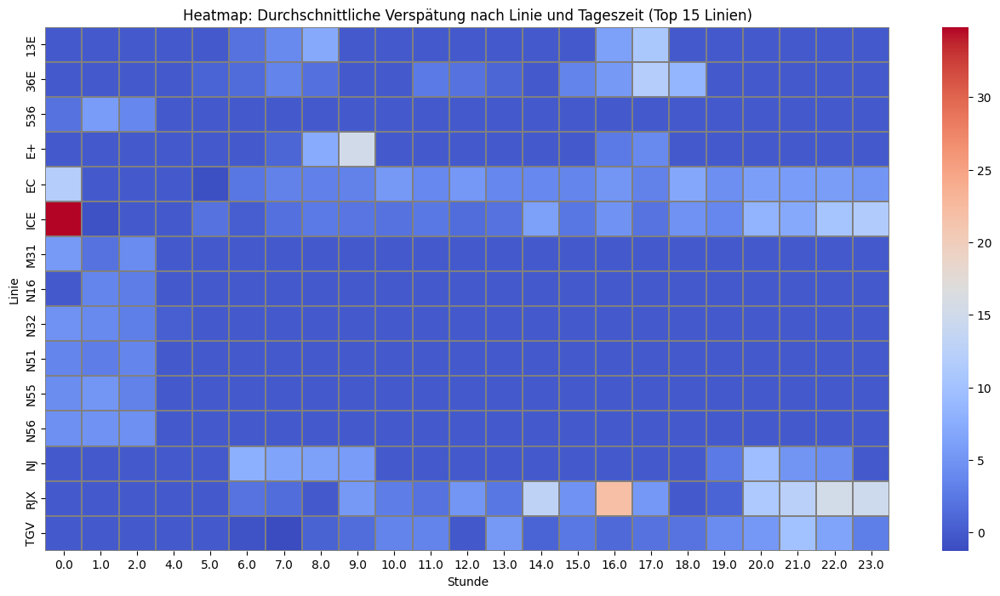

In [ ]:
# --- STABILE VERSION FÜR DIE HEATMAP ---

# 1) Wir definieren die Top 15 Linien (von df_lines_top20)
top15 = df_lines_top20["LINIEN_TEXT"].head(15).to_list()

# 2) Daten stark reduzieren: nur diese Linien + sinnvolle Filter
df_small = (
    df_complete
    .filter(pl.col("LINIEN_TEXT").is_in(top15))
    .filter(pl.col("delay_arrival_s").is_not_null())
    .with_columns([
        (pl.col("delay_arrival_s") / 60).alias("delay_min"),
        pl.col("ANKUNFTSZEIT").dt.hour().alias("hour")
    ])
    .filter((pl.col("delay_min") > -10) & (pl.col("delay_min") < 60))
    .select(["LINIEN_TEXT", "hour", "delay_min"])
    .collect()  # <<< jetzt klein genug zum Collect
)

# 3) Pivot vorbereiten
df_small_pd = df_small.to_pandas()

pivot = df_small_pd.pivot_table(
    index="LINIEN_TEXT",
    columns="hour",
    values="delay_min",
    aggfunc="mean"
).fillna(0)

# 4) Plotten
plt.figure(figsize=(16, 8))
sns.heatmap(
    pivot,
    cmap="coolwarm",
    linewidths=0.3,
    linecolor="gray"
)
plt.title("Heatmap: Durchschnittliche Verspätung nach Linie und Tageszeit (Top 15 Linien)")
plt.xlabel("Stunde")
plt.ylabel("Linie")
plt.show()

In [ ]:
import polars as pl

# Nur benötigte Spalten laden!
df_small = df_complete.select([
    "LINIEN_TEXT",
    "delay_arrival_s",
    "ANKUNFTSZEIT"
])

# Linien-Features extrem ressourcenschonend berechnen
line_features = (
    df_small.lazy()
    .with_columns([
        (pl.col("delay_arrival_s") / 60).alias("delay_min"),
        pl.col("ANKUNFTSZEIT").dt.hour().alias("hour"),
    ])
    .group_by("LINIEN_TEXT")
    .agg([
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.col("delay_min").std().alias("std_delay"),
        pl.col("delay_min").quantile(0.9).alias("p90_delay"),
        pl.len().alias("n_trains"),
        pl.when(pl.col("hour").is_in([16, 17, 18, 19]))
          .then(pl.col("delay_min"))
          .otherwise(None)
          .mean()
          .alias("rush_delay"),
    ])
    .collect(streaming=True)
)

line_features.head()

/tmp/ipykernel_34182/2769219963.py:29: DeprecationWarning: the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.
  .collect(streaming=True)


LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay
str,f64,f64,f64,u32,f64
"""601""",1.393207,1.55828,3.266667,156938,1.580534
"""504""",1.18704,1.591009,2.483333,43250,1.346023
"""384""",1.752984,2.500511,4.583333,6920,2.14692
"""883""",0.95498,0.962448,1.983333,3792,1.12892
"""732""",1.926545,1.858428,3.983333,69573,2.678449


In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler

# Datenframe in Pandas überführen
lf = line_features.to_pandas()

# Anzahl Züge log-transformieren (wegen extrem großer Unterschiede)
lf["log_n_trains"] = np.log1p(lf["n_trains"])

# Featurematrix auswählen
X = lf[["mean_delay", "std_delay", "p90_delay", "rush_delay", "log_n_trains"]]

# Standardisierung
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

print("Shape:", X_scaled.shape)
lf.head()

Shape: (1087, 5)


,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains
0,601,1.393207,1.558280,3.266667,156938,1.580534,11.963612
1,504,1.187040,1.591009,2.483333,43250,1.346023,10.674776
2,384,1.752984,2.500511,4.583333,6920,2.146920,8.842316
3,883,0.954980,0.962448,1.983333,3792,1.128920,8.240913
4,732,1.926545,1.858428,3.983333,69573,2.678449,11.150146


In [ ]:
# rush_delay = mean_delay ersetzen, falls NaN
lf["rush_delay"] = lf["rush_delay"].fillna(lf["mean_delay"])

# Kontrolle
print(lf.isna().sum())

LINIEN_TEXT     0
mean_delay      0
std_delay       0
p90_delay       0
n_trains        0
rush_delay      0
log_n_trains    0
dtype: int64


In [ ]:
X = lf[["mean_delay", "std_delay", "p90_delay", "rush_delay", "log_n_trains"]].to_numpy()

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

k=2, silhouette=0.9288
k=3, silhouette=0.2652
k=4, silhouette=0.4479
k=5, silhouette=0.4672
k=6, silhouette=0.3742
k=7, silhouette=0.3769
k=8, silhouette=0.3197


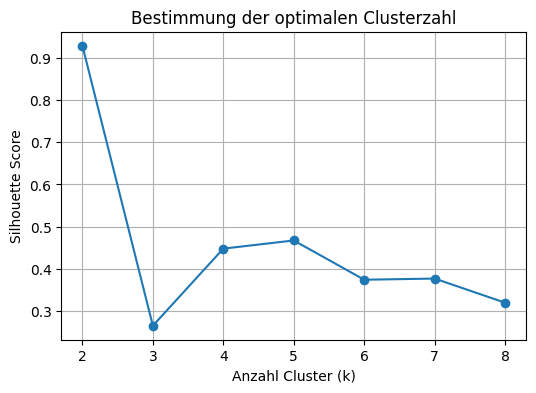

Optimales k: 2


,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains,cluster
0,601,1.393207,1.558280,3.266667,156938,1.580534,11.963612,0
1,504,1.187040,1.591009,2.483333,43250,1.346023,10.674776,0
2,384,1.752984,2.500511,4.583333,6920,2.146920,8.842316,0
3,883,0.954980,0.962448,1.983333,3792,1.128920,8.240913,0
4,732,1.926545,1.858428,3.983333,69573,2.678449,11.150146,0
5,N17,2.202441,35.865845,6.100000,1625,2.202441,7.393878,0
6,433,1.726835,2.412509,4.266667,58171,2.234634,10.971159,0
7,N75,1.421143,0.943964,2.733333,458,1.421143,6.129050,0
8,195,0.955975,2.717129,2.966667,12310,1.001944,9.418248,0
9,603,1.620446,1.538457,3.483333,232366,2.028016,12.356073,0


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Featurematrix X_scaled kommt aus vorheriger Zelle
scores = {}

for k in range(2, 9):
    km = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = km.fit_predict(X_scaled)
    score = silhouette_score(X_scaled, labels)
    scores[k] = score
    print(f"k={k}, silhouette={score:.4f}")

# Plot Silhouette Score
plt.figure(figsize=(6,4))
plt.plot(list(scores.keys()), list(scores.values()), marker="o")
plt.xlabel("Anzahl Cluster (k)")
plt.ylabel("Silhouette Score")
plt.title("Bestimmung der optimalen Clusterzahl")
plt.grid(True)
plt.show()

# Bestes k finden
best_k = max(scores, key=scores.get)
print("Optimales k:", best_k)

# Finales KMeans mit optimaler Clusterzahl
kmeans = KMeans(n_clusters=best_k, random_state=42, n_init="auto")
clusters = kmeans.fit_predict(X_scaled)

# Cluster speichern
lf["cluster"] = clusters

lf.head(10)

In [ ]:
from sklearn.cluster import KMeans

k = 5
km = KMeans(n_clusters=k, random_state=42, n_init="auto")
labels = km.fit_predict(X_scaled)

lf["cluster"] = labels

lf_sorted = lf.sort_values("cluster")
lf_sorted.head(20)

,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains,cluster
1,504,1.187040,1.591009,2.483333,43250,1.346023,10.674776,0
2,384,1.752984,2.500511,4.583333,6920,2.146920,8.842316,0
1059,615,1.511421,1.446967,3.183333,32600,1.685020,10.392098,0
1060,IC6,1.008650,2.965505,2.700000,6653,0.816387,8.802973,0
1061,213,1.316451,18.541437,3.500000,61420,1.755150,11.025507,0
1062,IR75,1.268968,2.014457,2.883333,12404,1.650917,9.425855,0
1063,RE80,1.284929,2.581707,2.916667,23986,1.243087,10.085267,0
1064,158,1.349892,1.717800,3.266667,56376,1.768199,10.939817,0
1065,S62,1.293263,1.415409,1.733333,2380,1.613662,7.775276,0
1067,S25,0.866103,1.218287,2.133333,32847,0.870768,10.399646,0


In [ ]:
lf[lf["cluster"] == 1].head(20)


,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains,cluster
7,N75,1.421143,0.943964,2.733333,458,1.421143,6.129050,1
10,m2,5.015432,8.875772,18.033333,162,4.054978,5.093750,1
13,N43,2.049000,2.675221,6.383333,250,2.049000,5.525453,1
16,M25,1.086432,0.895983,2.350000,398,1.086432,5.988961,1
17,259,1.922338,2.570473,4.700000,4091,1.738862,8.316789,1
27,M83,2.244276,1.580507,4.483333,527,2.244276,6.269096,1
30,N78,1.285783,0.872732,2.450000,517,1.285783,6.249975,1
37,SN65,1.591474,1.211002,2.700000,432,1.591474,6.070738,1
41,B23,1.689404,1.522808,3.616667,895,1.759583,6.797940,1
44,SN5,1.495579,1.468678,3.200000,1210,1.495579,7.099202,1


In [ ]:
lf[lf["cluster"] == 2].head(20)


,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains,cluster
72,IRE,31.688889,0.625907,32.333333,3,31.688889,1.386294,2


In [ ]:
lf[lf["cluster"] == 3].head(20)


,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains,cluster
739,713,12.299061,35.441476,48.483333,71,-28.161111,4.276666,3


In [ ]:
lf[lf["cluster"] == 4].head(20)

,LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,rush_delay,log_n_trains,cluster
5,N17,2.202441,35.865845,6.100000,1625,2.202441,7.393878,4
48,215,0.560908,29.029228,2.800000,90387,-0.826524,11.411867,4
81,204,-0.414016,48.373930,3.233333,67879,1.446364,11.125497,4
100,217,0.939132,20.393322,2.450000,61368,1.156131,11.024660,4
299,S50,0.402577,27.118035,2.716667,19462,0.654916,9.876271,4
360,207,0.391256,30.475695,2.616667,26823,0.741979,10.197052,4
440,R81,0.421546,33.402782,2.600000,9311,1.098562,9.139059,4
483,216,0.987336,23.418607,3.450000,26628,1.543046,10.189756,4
511,R82,-0.720848,50.306516,1.533333,4098,0.782032,8.318498,4
625,S23,0.045931,37.122445,2.733333,52699,0.885027,10.872371,4


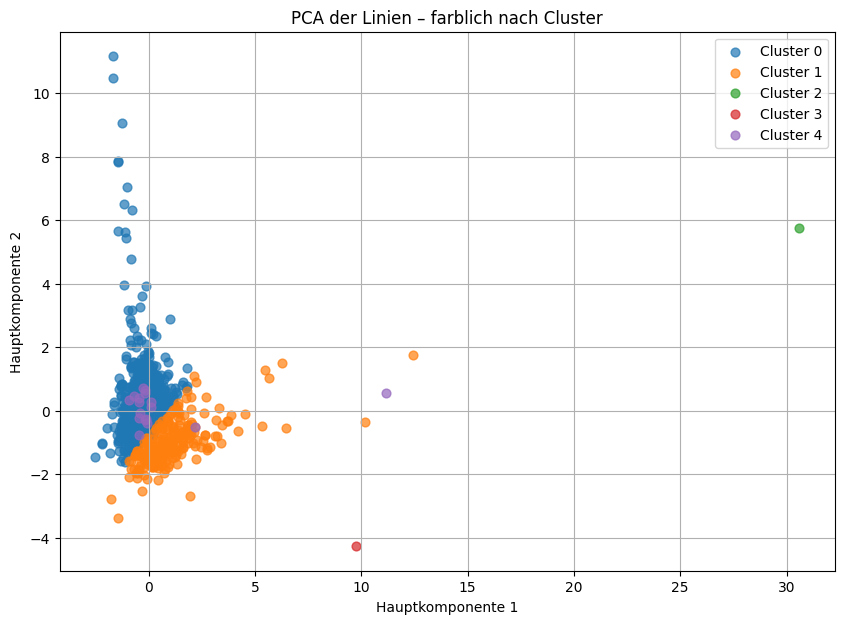

Erklärte Varianz PC1: 37.03%
Erklärte Varianz PC2: 24.03%

Gesamt (PC1 + PC2): 61.06%


In [ ]:
# --- PCA PLOT DER LINIENCLUSTER ---
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Numerical features für PCA
feat_cols = ["mean_delay", "std_delay", "p90_delay", "n_trains", "rush_delay", "log_n_trains"]

# NaNs entfernen (sicherheitshalber)
lf_clean = lf.dropna(subset=feat_cols).copy()

X = lf_clean[feat_cols]

# Standardisierung
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# PCA 2D
pca = PCA(n_components=2)
components = pca.fit_transform(X_scaled)

lf_clean["PC1"] = components[:, 0]
lf_clean["PC2"] = components[:, 1]

# Plot
plt.figure(figsize=(10, 7))
for c in sorted(lf_clean["cluster"].unique()):
    subset = lf_clean[lf_clean["cluster"] == c]
    plt.scatter(subset["PC1"], subset["PC2"], label=f"Cluster {c}", s=40, alpha=0.7)

plt.title("PCA der Linien – farblich nach Cluster")
plt.xlabel("Hauptkomponente 1")
plt.ylabel("Hauptkomponente 2")
plt.legend()
plt.grid(True)
plt.show()

# Erklärung der Varianz
print(f"Erklärte Varianz PC1: {pca.explained_variance_ratio_[0]:.2%}")
print(f"Erklärte Varianz PC2: {pca.explained_variance_ratio_[1]:.2%}")
print("\nGesamt (PC1 + PC2): {:.2%}".format(sum(pca.explained_variance_ratio_[:2])))

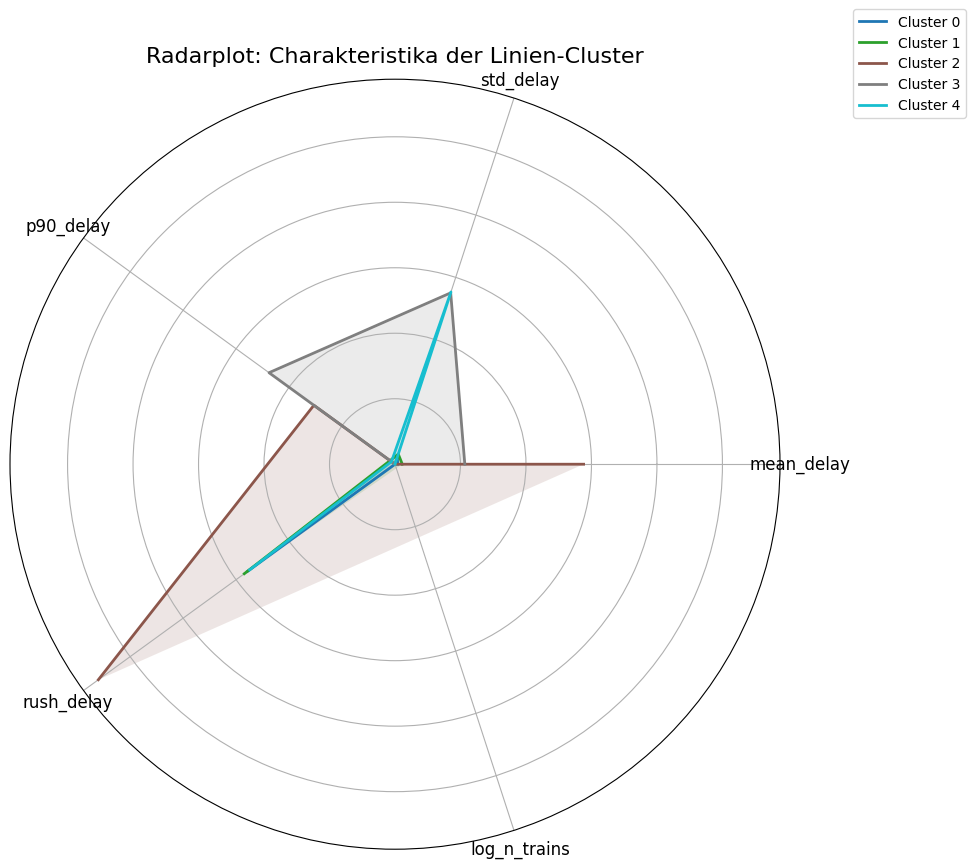

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# --- 1) Features definieren ---
features = ["mean_delay", "std_delay", "p90_delay", "rush_delay", "log_n_trains"]

# Sicherstellen, dass keine NaN in den Features stehen
lf_clean = lf.copy()
lf_clean["rush_delay"] = lf_clean["rush_delay"].fillna(lf_clean["mean_delay"])

# --- 2) Cluster-Mittelwerte berechnen ---
cluster_means = lf_clean.groupby("cluster")[features].mean()

# --- 3) Normalisieren auf 0–1 für Radarplot ---
cluster_norm = (cluster_means - cluster_means.min()) / (cluster_means.max() - cluster_means.max().min())

# --- 4) Radarplot vorbereiten ---
labels = features
num_vars = len(labels)

# Winkel für den Kreis
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Kreis schliessen

fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))

# Farbschema
colors = plt.cm.tab10(np.linspace(0, 1, len(cluster_norm)))

# --- 5) Radarlinien zeichnen ---
for idx, (cluster_id, row) in enumerate(cluster_norm.iterrows()):
    values = row.tolist()
    values += values[:1]  # Kreis schliessen

    ax.plot(angles, values, label=f"Cluster {cluster_id}", color=colors[idx], linewidth=2)
    ax.fill(angles, values, color=colors[idx], alpha=0.15)

# --- 6) Layout ---
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels, fontsize=12)

ax.set_yticklabels([])
ax.set_title("Radarplot: Charakteristika der Linien-Cluster", fontsize=16)
plt.legend(loc="upper right", bbox_to_anchor=(1.25, 1.1))

plt.show()

In [ ]:
import numpy as np
import folium
from branca.colormap import LinearColormap

# 1) Nur Schweizer Bahnhöfe mit Koordinaten
dienst_coord = dienst[
    (dienst["isoCountryCode"] == "CH") &
    (dienst["Geoposition"].notna()) &
    (dienst["number"].notna())
].copy()

# 2) Geoposition "lat, lon" in zwei Spalten splitten
dienst_coord[["lat", "lon"]] = dienst_coord["Geoposition"].str.split(",", n=1, expand=True)

dienst_coord["lat"] = dienst_coord["lat"].str.strip().astype(float)
dienst_coord["lon"] = dienst_coord["lon"].str.strip().astype(float)

dienst_coord = dienst_coord[["number", "lat", "lon"]]

dienst_coord.head()

,number,lat,lon
407,8500121,47.335083,7.291166
409,8500122,47.336687,7.246846
410,8500143,47.469920,7.048108
411,8500101,47.235238,7.227418
412,8500126,47.420916,7.080077


In [ ]:
import polars as pl

# Bahnhof-Koordinaten nach Polars, station_id als String
dienst_coord_pl = pl.from_pandas(dienst_coord).with_columns(
    pl.col("number").cast(pl.Utf8).alias("station_id")
).select(["station_id", "lat", "lon"])

# Nur Züge + sinnvolle Verspätungen
df_trains_geo = (
    df
    .filter(pl.col("PRODUKT_ID") == "Zug")
    .filter(pl.col("delay_arrival_s").is_not_null())
    .join(
        dienst_coord_pl.lazy(),
        left_on="BPUIC",
        right_on="station_id",
        how="inner"
    )
    .with_columns(
        (pl.col("delay_arrival_s") / 60).alias("delay_min")
    )
)

df_trains_geo.select(["LINIEN_TEXT", "BPUIC", "lat", "lon", "delay_min"]).head().collect()

LINIEN_TEXT,BPUIC,lat,lon,delay_min
str,str,f64,f64,f64
"""IR3""","""8503424""",47.698282,8.632756,1.9
"""RE3""","""8503424""",47.698282,8.632756,0.7
"""IR3""","""8503424""",47.698282,8.632756,0.516667
"""RE3""","""8503424""",47.698282,8.632756,0.3
"""IR3""","""8503424""",47.698282,8.632756,1.383333


In [ ]:
# Linien-Statistik (nur Linien mit genügend Daten, z.B. >= 100 Fahrten)
line_geo = (
    df_trains_geo
    .group_by("LINIEN_TEXT")
    .agg([
        pl.col("lat").mean().alias("lat"),
        pl.col("lon").mean().alias("lon"),
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.len().alias("n_trains")
    ])
    .filter(pl.col("n_trains") >= 100)   # kleine Linien rausfiltern
    .collect()
    .to_pandas()
)

print(f"Anzahl Linien auf der Karte: {len(line_geo)}")
line_geo.head()

Anzahl Linien auf der Karte: 199


,LINIEN_TEXT,lat,lon,mean_delay,n_trains
0,S30,47.022487,7.764681,1.321708,43011
1,IR65,47.052540,7.329927,0.724977,6197
2,IR38,46.642290,9.685535,2.239739,8690
3,SN41,47.509526,8.647329,0.821962,192
4,SN4,47.334373,8.527565,0.414187,672


In [ ]:
# Verspätungsbereich für Farbcodierung bestimmen
vmin = max(0, line_geo["mean_delay"].min())
vmax = min(10, line_geo["mean_delay"].max())

colormap = LinearColormap(
    colors=["#1a9850", "#fee08b", "#d73027"],  # grün → gelb → rot
    vmin=vmin,
    vmax=vmax
)
colormap.caption = "Durchschnittliche Verspätung der Linie (Minuten)"

# Basiskarte
m_lines = folium.Map(location=[46.8, 8.2], zoom_start=8, tiles="cartodbpositron")

# Kreise für jede Linie
for _, row in line_geo.iterrows():
    delay = row["mean_delay"]
    n = row["n_trains"]
    lat = row["lat"]
    lon = row["lon"]
    line = row["LINIEN_TEXT"]
    
    # Radius abhängig vom Verkehrsaufkommen (log-skaliert)
    radius = 3 + 2 * np.log10(n + 1)
    
    folium.CircleMarker(
        location=[lat, lon],
        radius=radius,
        color=colormap(delay),
        fill=True,
        fill_opacity=0.8,
        weight=1,
        popup=folium.Popup(
            f"<b>Linie:</b> {line}<br>"
            f"<b>Durchschnittliche Verspätung:</b> {delay:.2f} min<br>"
            f"<b>Anzahl Fahrten:</b> {n:,}",
            max_width=250
        ),
        tooltip=f"{line}: {delay:.2f} min (n={n})"
    ).add_to(m_lines)

colormap.add_to(m_lines)

# Titel-Overlay
title_html = '''
<div style="position: fixed; 
            top: 10px; left: 50px; width: 420px; height: 55px; 
            background-color: white; border:2px solid grey; z-index:9999; 
            font-size:14px; padding: 8px">
<b>Verspätungen nach Linie – Schweiz (September 2025)</b><br>
Kreisfarbe: durchschnittliche Verspätung &nbsp;|&nbsp; Kreisgröße: Anzahl Fahrten
</div>
'''
m_lines.get_root().html.add_child(folium.Element(title_html))

m_lines

In [ ]:
# --- Ultra-schlank laden ---
df_linien = (
    df_complete
    .select([
        "LINIEN_TEXT",
        (pl.col("delay_arrival_s") / 60).alias("delay_min")
    ])
    .filter(
        pl.col("LINIEN_TEXT").is_not_null() &
        pl.col("delay_min").is_not_null() &
        (pl.col("delay_min") > -10) &
        (pl.col("delay_min") < 60)
    )
)

# --- In separate LazyFrame überführen (optimiert) ---
lf = df_linien.lazy()

# --- Jetzt die Aggregation ---
linien_stats = (
    lf
    .group_by("LINIEN_TEXT")
    .agg([
        pl.col("delay_min").mean().alias("mean_delay"),
        pl.col("delay_min").std().alias("std_delay"),
        pl.col("delay_min").quantile(0.9).alias("p90_delay"),
        pl.len().alias("n_trains")
    ])
    .filter(pl.col("n_trains") > 200)   # wichtige Stabilisierung
    .collect(streaming=True)            # wichtig!
)

linien_stats.head()

/tmp/ipykernel_58068/2518736540.py:30: DeprecationWarning: the `streaming` parameter was deprecated in 1.25.0; use `engine` instead.
  .collect(streaming=True)            # wichtig!


LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains
str,f64,f64,f64,u32
"""773""",1.160544,0.655042,1.816667,1753
"""305""",1.665956,1.528617,3.35,28688
"""150""",1.381663,1.214819,2.8,35532
"""N91""",2.462558,1.910375,5.35,1152
"""223""",1.539379,1.252176,2.966667,28325


In [ ]:
linien_stats_clean = (
    linien_stats
    .with_columns([
        pl.col("LINIEN_TEXT")
          .str.replace_all(r"[^A-Za-z0-9]", "")  # nur Buchstaben/Zahlen behalten
          .str.to_uppercase()
          .alias("line_norm")
    ])
)

linien_stats_clean.head()

LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,line_norm
str,f64,f64,f64,u32,str
"""773""",1.160544,0.655042,1.816667,1753,"""773"""
"""305""",1.665956,1.528617,3.35,28688,"""305"""
"""150""",1.381663,1.214819,2.8,35532,"""150"""
"""N91""",2.462558,1.910375,5.35,1152,"""N91"""
"""223""",1.539379,1.252176,2.966667,28325,"""223"""


In [ ]:
linien_features = (
    linien_stats_clean
    .with_columns([
        pl.col("n_trains").cast(pl.Float64).log().alias("log_n_trains"),

        # rush_delay = mean_delay (keine NaNs mehr)
        pl.col("mean_delay").alias("rush_delay")
    ])
)

linien_features.head()

LINIEN_TEXT,mean_delay,std_delay,p90_delay,n_trains,line_norm,log_n_trains,rush_delay
str,f64,f64,f64,u32,str,f64,f64
"""773""",1.160544,0.655042,1.816667,1753,"""773""",7.469084,1.160544
"""305""",1.665956,1.528617,3.35,28688,"""305""",10.264234,1.665956
"""150""",1.381663,1.214819,2.8,35532,"""150""",10.478189,1.381663
"""N91""",2.462558,1.910375,5.35,1152,"""N91""",7.049255,2.462558
"""223""",1.539379,1.252176,2.966667,28325,"""223""",10.2515,1.539379


In [ ]:
import geopandas as gpd

# GeoJSON laden
gdf_lines = gpd.read_file("../data/external/linie-mit-polygon.geojson")

gdf_lines.head(), len(gdf_lines)

(                                        geo_point_2d spurweite  km_agm_von  \
 0  {'lon': 7.901426863458719, 'lat': 46.623317862...         M    8200.000   
 1  {'lon': 6.838911636322875, 'lat': 46.602544260...         N   25680.000   
 2  {'lon': 8.683365976902179, 'lat': 47.453436445...         N   54000.000   
 3  {'lon': 8.682949052423984, 'lat': 47.452919566...         N   53872.500   
 4  {'lon': 6.957136403406592, 'lat': 47.544121957...         N  456212.846   
 
    km_agm_bis bp_anfang       bp_anf_bez bp_ende    bp_end_bez  linienr  \
 0   10420.000      ZWEI   Zweilütschinen    SAWE      Sandweid      311   
 1   30499.150      CHAP  Chapelle (diag)      VD     Vauderens      250   
 2   59747.718      MBGW     Mülberg West    TOEM     Tössmühle     9780   
 3   59781.211      MBGO      Mülberg Ost    TOEM     Tössmühle     9781   
 4  459728.128      MORV       Morvillars    GVIL  Grandvillars      245   
 
                         liniename  \
 0  Interlaken Ost - Lauterb

In [ ]:
import folium

# Zentrum der CH
m = folium.Map(location=[46.8, 8.3], zoom_start=8, tiles="cartodbpositron")

def style_function(feature):
    return {
        "color": "#0055A4",   # SBB-Blau
        "weight": 2,
        "opacity": 0.8
    }

folium.GeoJson(
    gdf_lines,
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=["linienr", "liniename"],
        aliases=["Liniennummer:", "Linienname:"]
    )
).add_to(m)

m

In [ ]:
unique_lines = (
    df.select(pl.col("LINIEN_TEXT").unique())
      .collect()
      .to_pandas()["LINIEN_TEXT"]
)

# Heuristik: Bahnlinien identifizieren
train_lines = []

for ln in unique_lines:
    if isinstance(ln, str):
        # typische Bahnlinien
        if ln.startswith(("IC", "IR", "RE", "RJ", "RJX", "EC", "ICE", "TGV", "PE")):
            train_lines.append(ln)
        elif ln.startswith("S") and ln[1:].isdigit():
            train_lines.append(ln)
        elif ln.isdigit() and len(ln) <= 2:
            train_lines.append(ln)

train_lines_sorted = sorted(set(train_lines))
train_lines_sorted

['1',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '2',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '3',
 '30',
 '31',
 '32',
 '33',
 '34',
 '35',
 '36',
 '37',
 '38',
 '39',
 '4',
 '40',
 '41',
 '42',
 '43',
 '44',
 '45',
 '46',
 '47',
 '48',
 '49',
 '5',
 '50',
 '51',
 '52',
 '53',
 '54',
 '55',
 '56',
 '57',
 '58',
 '59',
 '6',
 '60',
 '61',
 '62',
 '63',
 '64',
 '65',
 '66',
 '67',
 '68',
 '69',
 '7',
 '70',
 '71',
 '72',
 '73',
 '74',
 '75',
 '76',
 '77',
 '78',
 '8',
 '80',
 '81',
 '82',
 '83',
 '84',
 '85',
 '86',
 '87',
 '88',
 '89',
 '9',
 '90',
 '91',
 '92',
 '93',
 '94',
 '97',
 '98',
 '99',
 'EC',
 'IC',
 'IC1',
 'IC2',
 'IC21',
 'IC3',
 'IC5',
 'IC51',
 'IC6',
 'IC61',
 'IC8',
 'IC81',
 'IC87',
 'ICE',
 'IR',
 'IR13',
 'IR15',
 'IR16',
 'IR17',
 'IR26',
 'IR27',
 'IR3',
 'IR35',
 'IR36',
 'IR37',
 'IR38',
 'IR46',
 'IR57',
 'IR65',
 'IR66',
 'IR70',
 'IR75',
 'IR90',
 'IR95',
 'IRE',
 'IRLEX',
 'IRLIX',
 'IRVAE',
 'PE',


In [ ]:
df_columns = df.schema
df_columns

: 